In [1]:
import kagglehub

# Download latest version
path = kagglehub.dataset_download("msambare/fer2013")

print("Path to dataset files:", path)


100%|██████████| 60.3M/60.3M [00:00<00:00, 182MB/s]

Extracting files...


Path to dataset files: /root/.cache/kagglehub/datasets/msambare/fer2013/versions/1


In [2]:
import os

# Define the path where the dataset is stored
dataset_path = "/root/.cache/kagglehub/datasets/msambare/fer2013/versions/1"

# List all files in the dataset directory
for file_name in os.listdir(dataset_path):
    print("File:", file_name)


File: test
File: train


In [3]:
Map = {'angry': '0', 'disgust': '1', 'fear': '2', 'happy': '3', 'neutral': '4', 'sad': '5', 'surprise': '6'}

In [4]:
import tensorflow as tf
import numpy as np
import cv2
import matplotlib.pyplot as plt
import os

In [5]:
im_arr=cv2.imread('/root/.cache/kagglehub/datasets/msambare/fer2013/versions/1/train/0/Training_10118481.jpg')

In [6]:
im_arr.shape

(48, 48, 3)

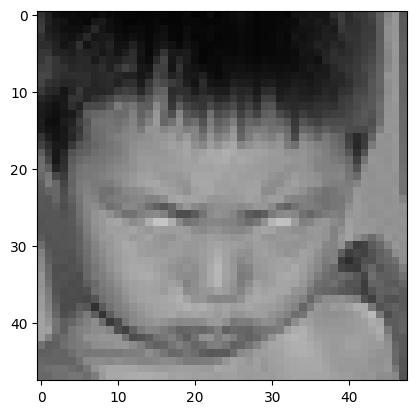

In [7]:
plt.imshow(im_arr)

In [8]:
data_train='/root/.cache/kagglehub/datasets/msambare/fer2013/versions/1/train/'

In [9]:
classes=['0','1','2','3','4','5','6']

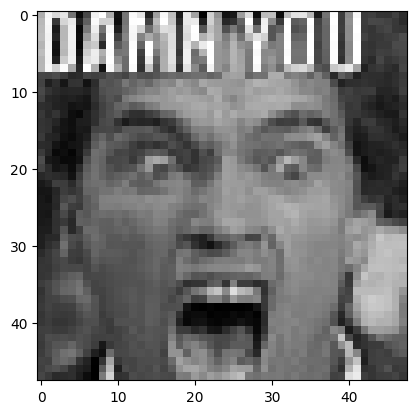

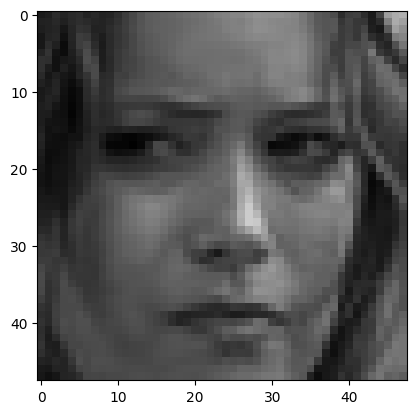

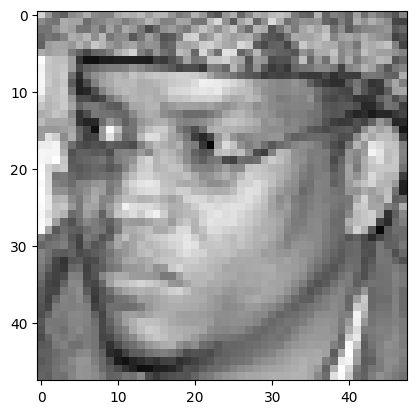

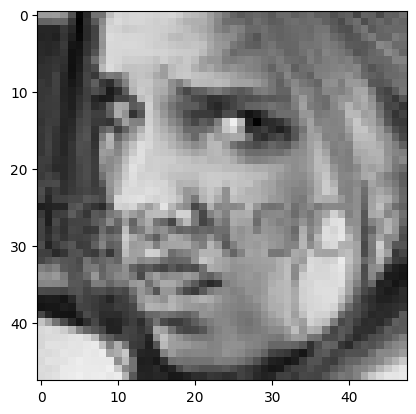

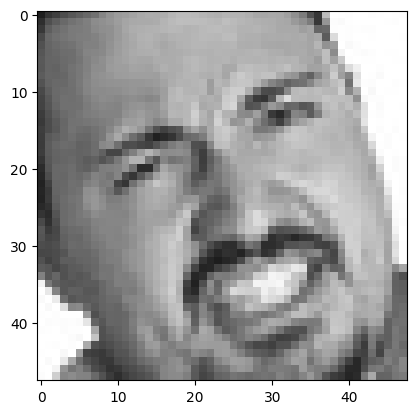

...

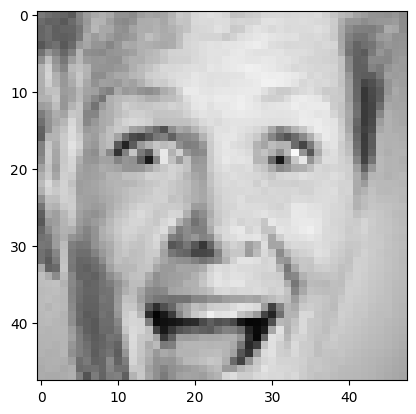

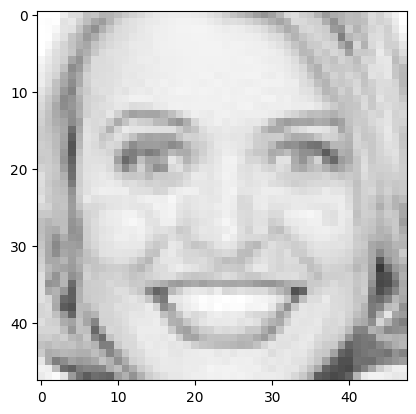

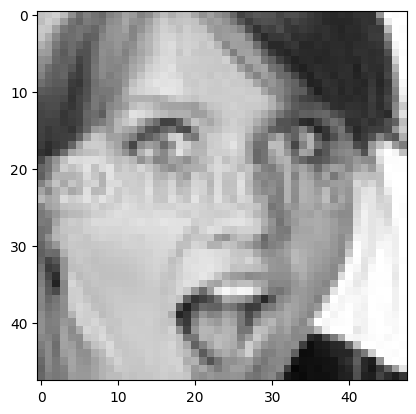

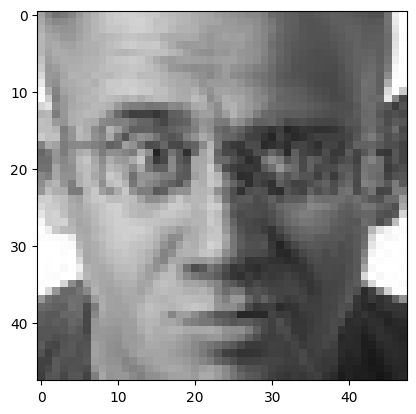

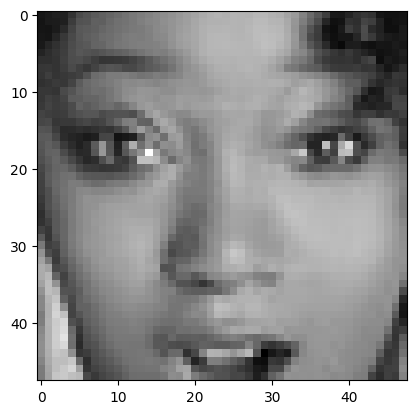

In [10]:
for c in classes:
    path=os.path.join(data_train,c)
    for img in os.listdir(path)[:5]:
        image_path=os.path.join(path,img)
        image=cv2.imread(image_path)
        plt.imshow(cv2.cvtColor(image,cv2.COLOR_BGR2RGB))
        plt.show()

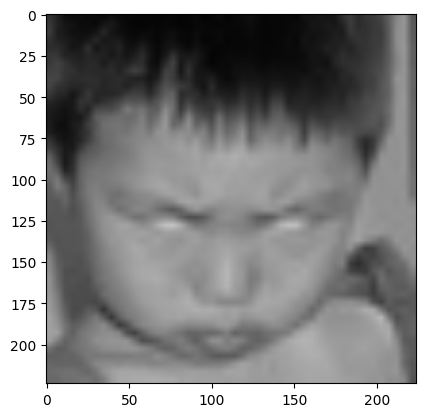

In [11]:
img_size=224
new_arr=cv2.resize(im_arr,(img_size,img_size))
plt.imshow(cv2.cvtColor(new_arr,cv2.COLOR_BGR2RGB))
plt.show()

In [12]:
new_arr.shape

(224, 224, 3)

In [13]:
train_data=[]

def create_train_data():
  for c in classes:
    path=os.path.join(data_train,c)
    class_num=classes.index(c)
    for img in os.listdir(path):
      try:
        image_path=os.path.join(path,img)
        img_arr=cv2.imread(image_path)
        new_arr=cv2.resize(img_arr,(img_size,img_size))
        train_data.append([new_arr,class_num])
      except Exception as e:
        pass

In [14]:
create_train_data()

In [15]:
len(train_data)

28709

In [16]:
total=0
for c in classes:
    path=os.path.join(data_train,c)
    length=len(os.listdir(path))
    total+=length
    print(c,':',length)
print(total)

0 : 3995
1 : 436
2 : 4097
3 : 7215
4 : 4965
5 : 4830
6 : 3171
28709


In [17]:
import random
random.shuffle(train_data)

In [18]:
X=[]
Y=[]
for features,labels in train_data:
  X.append(features/255.0)
  Y.append(labels)

X=np.array(X).reshape(-1,img_size,img_size,3)


In [19]:
X.shape

(28709, 224, 224, 3)

In [20]:
Y=np.array(Y)

In [21]:
Y.shape

(28709,)

In [22]:
from tensorflow import keras
from tensorflow.keras import layers

In [23]:
model = tf.keras.applications.MobileNetV3Small(input_shape=(224, 224, 3), include_top=False)

4334752/4334752 [==============================] - 0s 0us/step


In [24]:
model.summary()

Model: "MobilenetV3small"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 rescaling (Rescaling)       (None, 224, 224, 3)          0         ['input_1[0][0]']             
                                                                                                  
 Conv (Conv2D)               (None, 112, 112, 16)         432       ['rescaling[0][0]']           
                                                                                                  
 Conv/BatchNorm (BatchNorma  (None, 112, 112, 16)         64        ['Conv[0][0]']                
 lization)                                                                         

#Transfer learning

In [25]:
base_input = model.layers[0].input
base_output = model.layers[-2].output

In [26]:
base_input

<KerasTensor: shape=(None, 224, 224, 3) dtype=float32 (created by layer 'input_1')>

In [27]:
base_output

<KerasTensor: shape=(None, 7, 7, 576) dtype=float32 (created by layer 'tf.math.multiply_26')>

In [28]:
final_output = layers.Dense(256, activation='relu')(base_output)
final_output = layers.Dense(128, activation='relu')(final_output)
final_output = layers.Dense(64, activation='relu')(final_output)
final_output = layers.Flatten()(final_output)
final_output = layers.Dense(7, activation='softmax')(final_output)  # 7 classes

In [29]:
final_output

<KerasTensor: shape=(None, 7) dtype=float32 (created by layer 'dense_3')>

In [30]:
new_model=keras.Model(inputs=base_input,outputs=final_output)
new_model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 rescaling (Rescaling)       (None, 224, 224, 3)          0         ['input_1[0][0]']             
                                                                                                  
 Conv (Conv2D)               (None, 112, 112, 16)         432       ['rescaling[0][0]']           
                                                                                                  
 Conv/BatchNorm (BatchNorma  (None, 112, 112, 16)         64        ['Conv[0][0]']                
 lization)                                                                                    

In [31]:
new_model.compile(loss='sparse_categorical_crossentropy', optimizer='SGD', metrics=['accuracy'])

In [32]:
new_model.fit(X,Y,epochs=25)

Epoch 1/25
898/898 [==============================] - 234s 253ms/step - loss: 1.5412 - accuracy: 0.3975
Epoch 2/25
898/898 [==============================] - 226s 252ms/step - loss: 1.2626 - accuracy: 0.5210
Epoch 3/25
898/898 [==============================] - 224s 250ms/step - loss: 1.1422 - accuracy: 0.5708
Epoch 4/25
898/898 [==============================] - 224s 250ms/step - loss: 1.0576 - accuracy: 0.6047
Epoch 5/25
898/898 [==============================] - 224s 250ms/step - loss: 0.9877 - accuracy: 0.6338
Epoch 6/25
898/898 [==============================] - 225s 250ms/step - loss: 0.9208 - accuracy: 0.6581
Epoch 7/25
898/898 [==============================] - 225s 251ms/step - loss: 0.8597 - accuracy: 0.6828
Epoch 8/25
898/898 [==============================] - 224s 249ms/step - loss: 0.7931 - accuracy: 0.7101
Epoch 9/25
898/898 [==============================] - 222s 248ms/step - loss: 0.7284 - accuracy: 0.7356
Epoch 10/25
898/898 [==============================] - 222s 247m

In [33]:
import os

# Define the path where you want to save the model
save_path = '/root/.cache/kagglehub/datasets/msambare/fer2013/versions/'

# Ensure the directory exists
os.makedirs(save_path, exist_ok=True)

# Rename layers to avoid '/' characters in names
for layer in model.layers:
    if '/' in layer.name:
        layer._name = layer.name.replace('/', '_')  # Replace '/' with '_'

# Save the trained model to the specified directory
fixed_model_path = os.path.join(save_path, 'my_model_fixed.h5')
model.save(fixed_model_path)

print(f"Model saved successfully at {fixed_model_path}")


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Model saved successfully at /root/.cache/kagglehub/datasets/msambare/fer2013/versions/my_model_fixed.h5


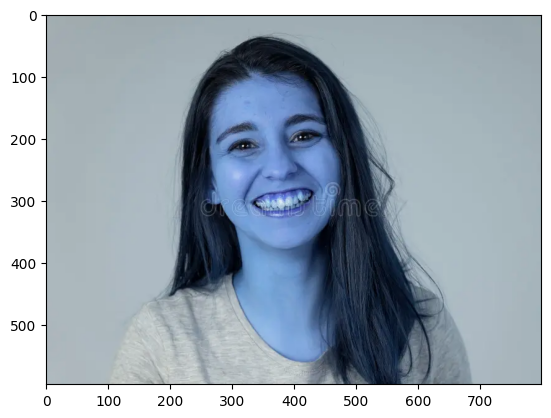

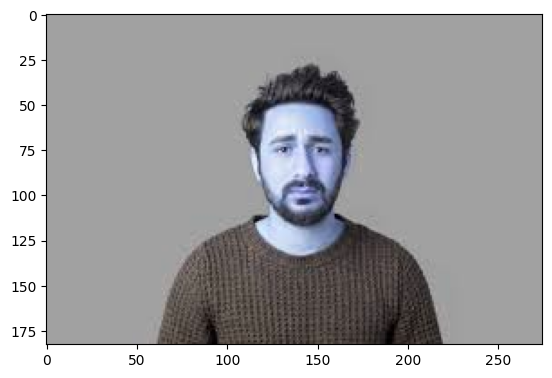

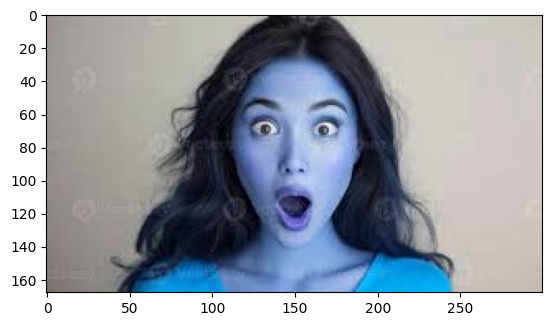

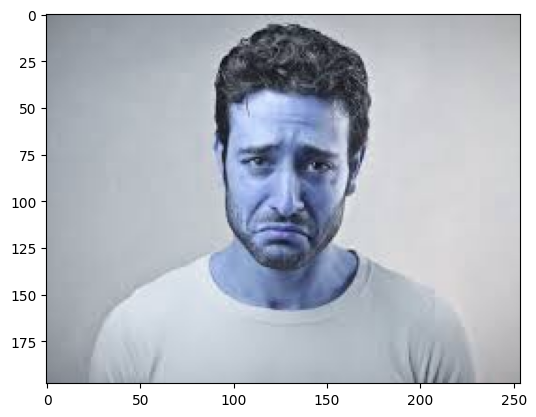

In [34]:
img1_path = '/root/.cache/kagglehub/datasets/msambare/fer2013/versions/happy.jpeg'
img2_path = '/root/.cache/kagglehub/datasets/msambare/fer2013/versions/sad.jpeg'
img4_path = '/root/.cache/kagglehub/datasets/msambare/fer2013/versions/sad2.jpeg'
img3_path='/root/.cache/kagglehub/datasets/msambare/fer2013/versions/suprised.jpeg'
dir=[img1_path,img2_path,img3_path,img4_path]
for i in dir:
      img = cv2.imread(i)
      plt.imshow(img)
      plt.show()

In [35]:
faceMark = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

In [55]:
frame=cv2.imread('/root/.cache/kagglehub/datasets/msambare/fer2013/versions/happy.jpeg')

In [56]:
frame.shape

(597, 800, 3)

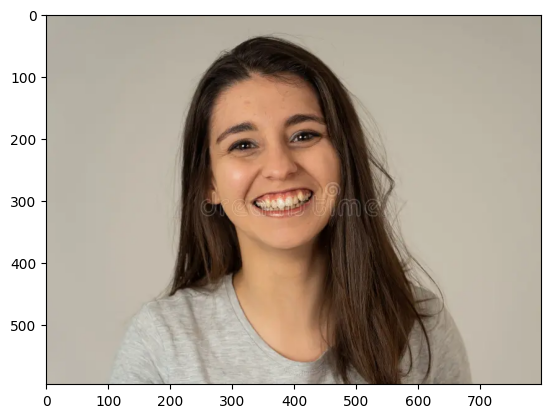

In [57]:
plt.imshow(cv2.cvtColor(frame,cv2.COLOR_BGR2RGB))

In [58]:
gray=cv2.cvtColor(frame,cv2.COLOR_BGR2GRAY)

In [59]:
gray.shape

(597, 800)

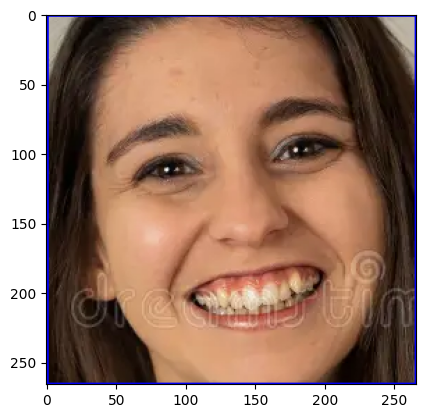

In [60]:
if faceMark.empty():
    print("Error: Could not load face cascade classifier.")
else:
    faces = faceMark.detectMultiScale(gray, 1.1, 4)
    for (x, y, w, h) in faces:
        cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 0, 0), 2)

        # Extract face ROI
        face_roi = frame[y:y + h, x:x + w]

        # Display face ROI
        plt.imshow(cv2.cvtColor(face_roi, cv2.COLOR_BGR2RGB))
        plt.show()

In [61]:
final_image=cv2.resize(face_roi,(224,224))
final_image=np.expand_dims(final_image,axis=0)
final_image=final_image/255.0

In [62]:
pred=new_model.predict(final_image)

1/1 [==============================] - 0s 41ms/step


In [63]:
np.argmax(pred)

3

In [71]:
test_data=[]
data_test='/root/.cache/kagglehub/datasets/msambare/fer2013/versions/1/test/'
def create_test_data():
  for c in classes:
    path=os.path.join(data_test,c)
    class_num=classes.index(c)
    for img in os.listdir(path):
      try:
        image_path=os.path.join(path,img)
        img_arr=cv2.imread(image_path)
        new_arr=cv2.resize(img_arr,(img_size,img_size))
        train_data.append([new_arr,class_num])
      except Exception as e:
        pass

In [72]:
create_test_data()

In [73]:
random.shuffle(test_data)

In [74]:
X_test=[]
Y_test=[]
for features,labels in train_data:
  X_test.append(features/255.0)
  Y_test.append(labels)

X_test=np.array(X_test).reshape(-1,img_size,img_size,3)

In [76]:
Y_test=np.array(Y_test)

In [77]:
loss, accuracy = new_model.evaluate(X_test, Y_test)
print("Test Accuracy:", accuracy)

1122/1122 [==============================] - 68s 58ms/step - loss: 10.6801 - accuracy: 0.2538
Test Accuracy: 0.25376877188682556


1/1 [==============================] - 0s 45ms/step


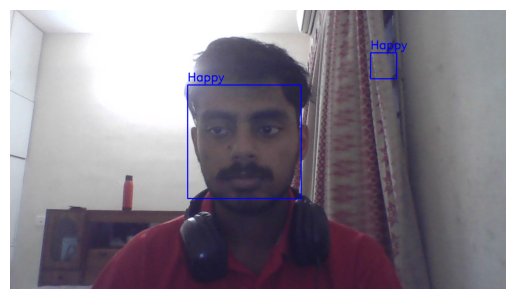

1/1 [==============================] - 0s 42ms/step


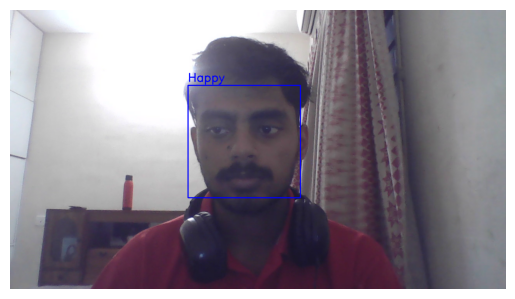

1/1 [==============================] - 0s 40ms/step


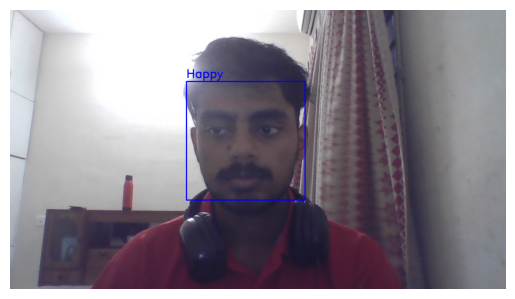

1/1 [==============================] - 0s 39ms/step


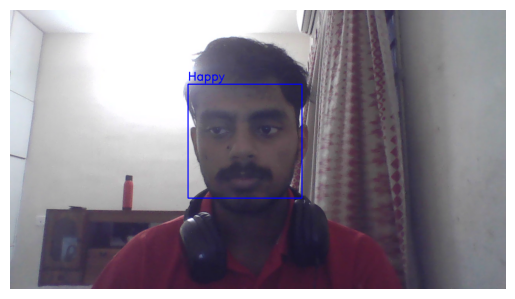

1/1 [==============================] - 0s 41ms/step


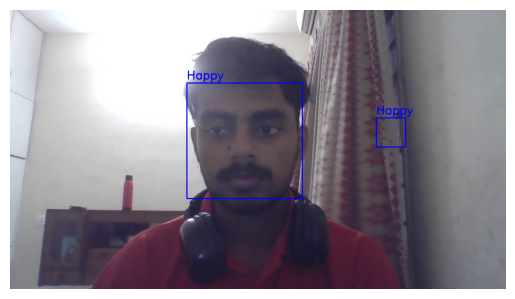

1/1 [==============================] - 0s 43ms/step


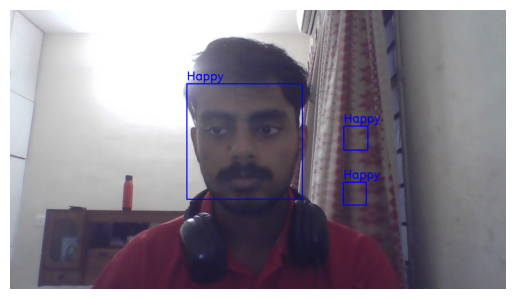

1/1 [==============================] - 0s 40ms/step


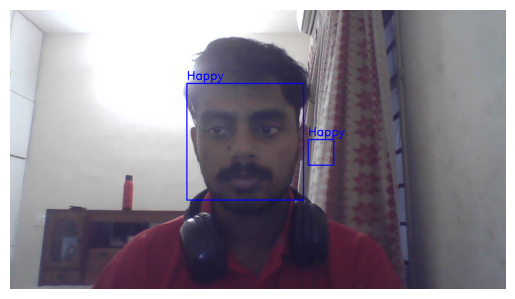

1/1 [==============================] - 0s 37ms/step


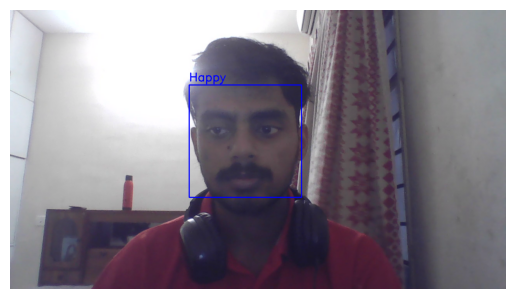

1/1 [==============================] - 0s 37ms/step


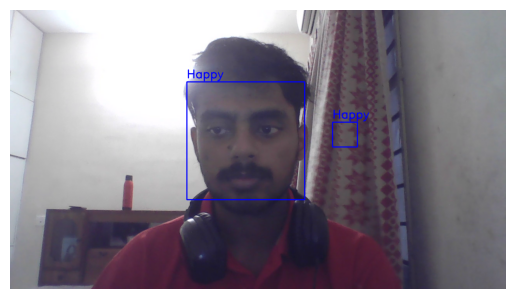

1/1 [==============================] - 0s 37ms/step


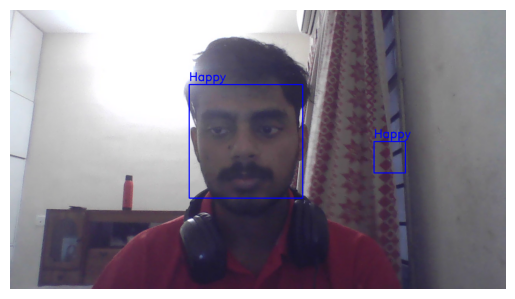

1/1 [==============================] - 0s 37ms/step


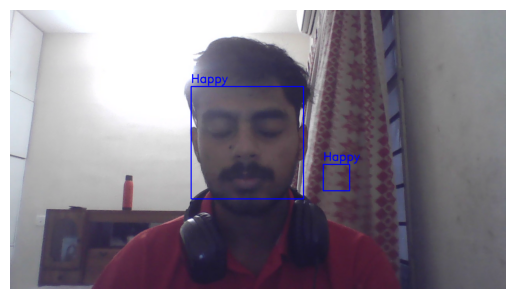

1/1 [==============================] - 0s 37ms/step


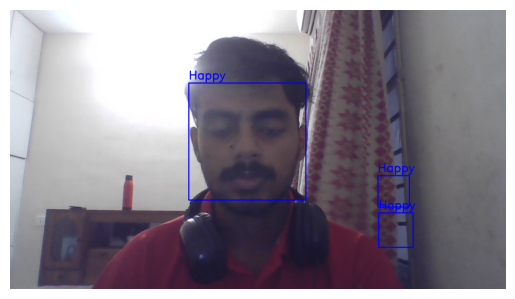

1/1 [==============================] - 0s 36ms/step


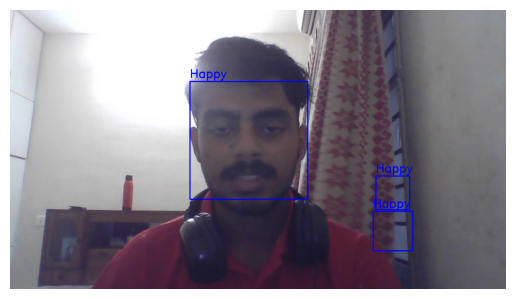

1/1 [==============================] - 0s 37ms/step


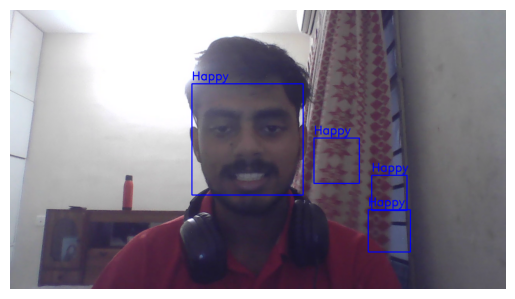

1/1 [==============================] - 0s 37ms/step


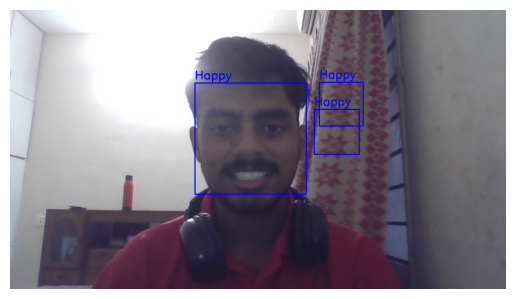

1/1 [==============================] - 0s 36ms/step


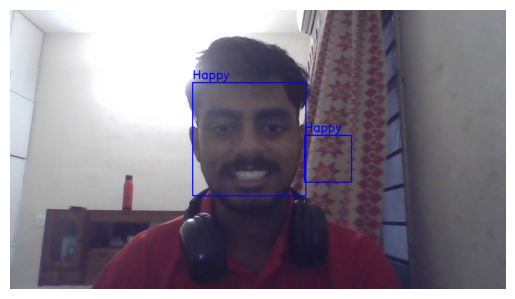

1/1 [==============================] - 0s 39ms/step


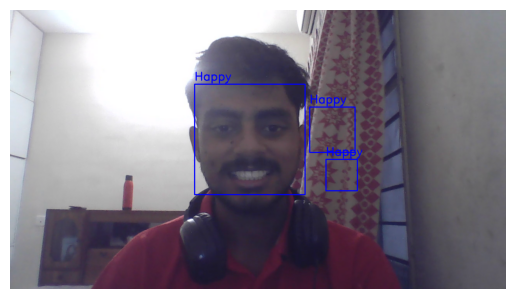

1/1 [==============================] - 0s 37ms/step


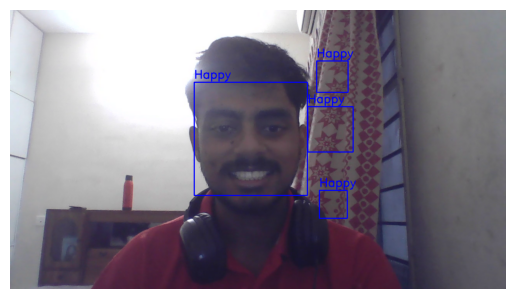

1/1 [==============================] - 0s 38ms/step


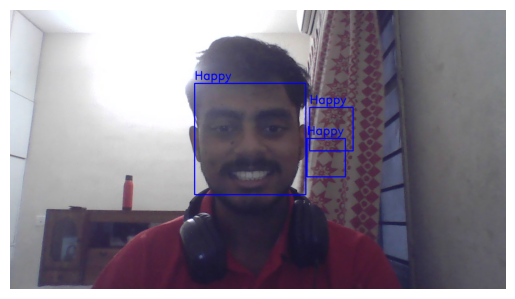

1/1 [==============================] - 0s 36ms/step


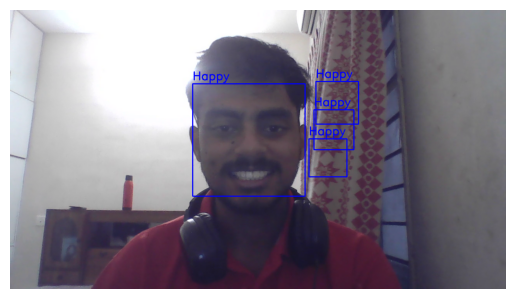

1/1 [==============================] - 0s 37ms/step


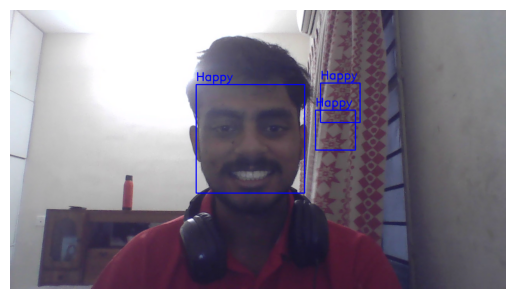

1/1 [==============================] - 0s 37ms/step


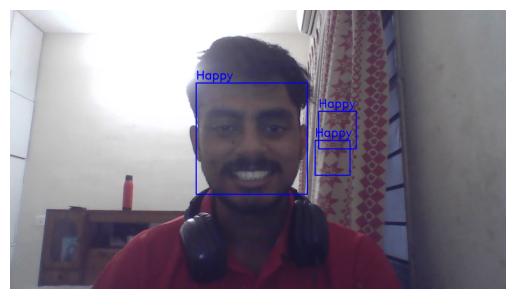

1/1 [==============================] - 0s 36ms/step


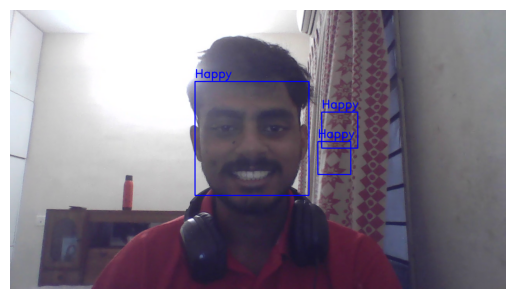

1/1 [==============================] - 0s 35ms/step


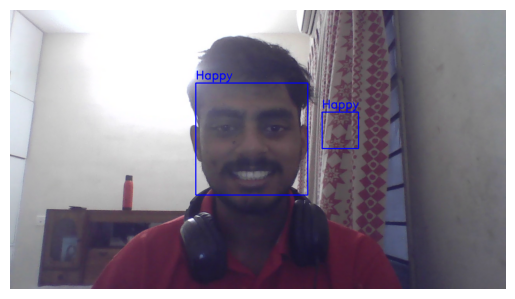

1/1 [==============================] - 0s 36ms/step


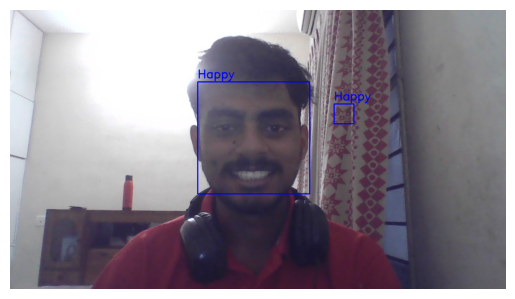

1/1 [==============================] - 0s 34ms/step


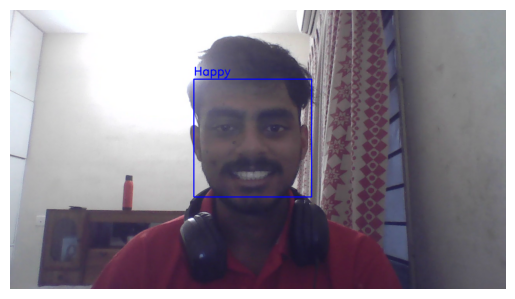

1/1 [==============================] - 0s 34ms/step


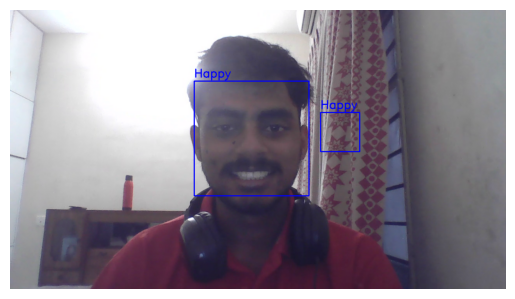

1/1 [==============================] - 0s 36ms/step


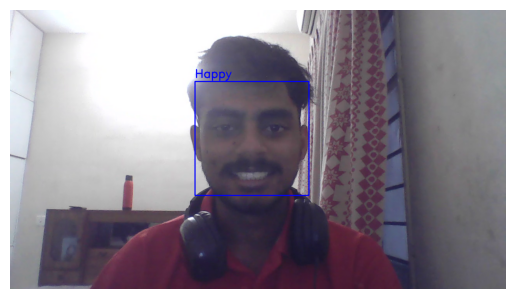

1/1 [==============================] - 0s 34ms/step


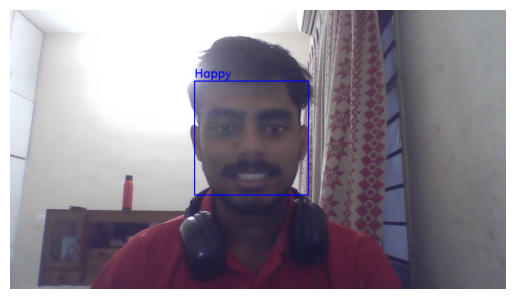

1/1 [==============================] - 0s 35ms/step


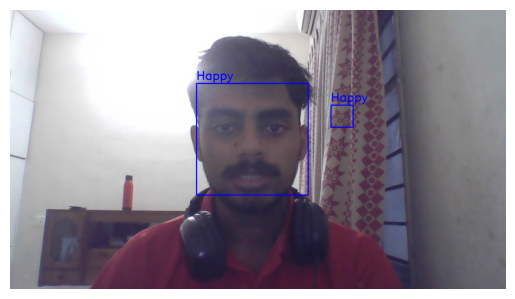

1/1 [==============================] - 0s 36ms/step


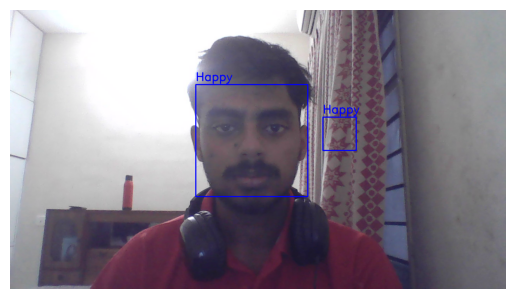

1/1 [==============================] - 0s 37ms/step


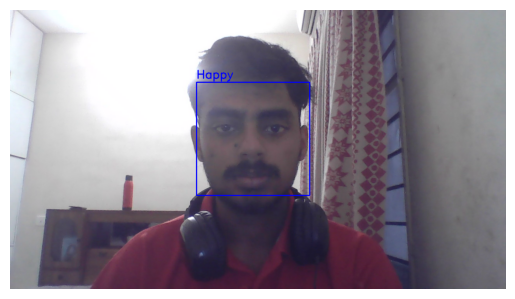

1/1 [==============================] - 0s 38ms/step


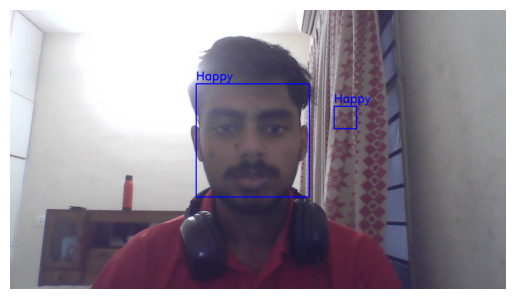

1/1 [==============================] - 0s 38ms/step


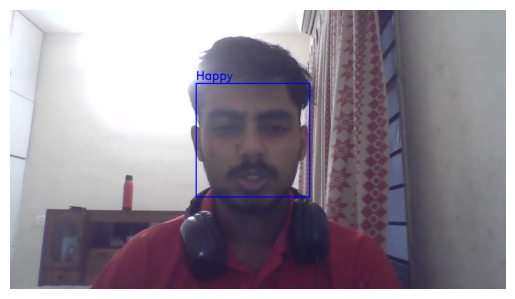

1/1 [==============================] - 0s 37ms/step


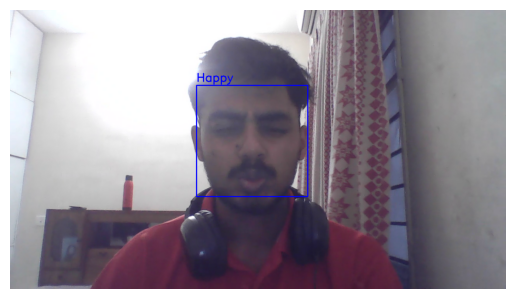

1/1 [==============================] - 0s 36ms/step


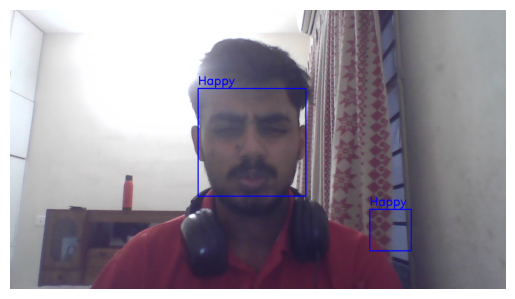

1/1 [==============================] - 0s 36ms/step


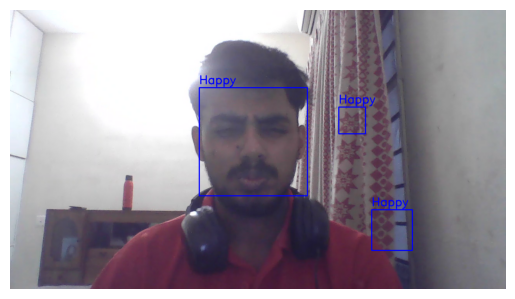

1/1 [==============================] - 0s 38ms/step


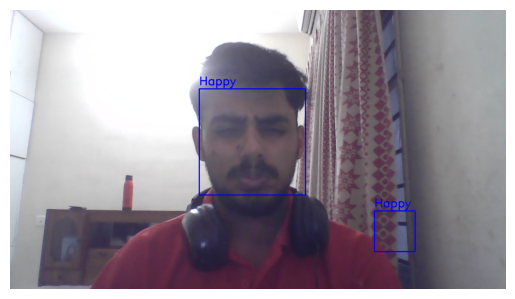

1/1 [==============================] - 0s 37ms/step


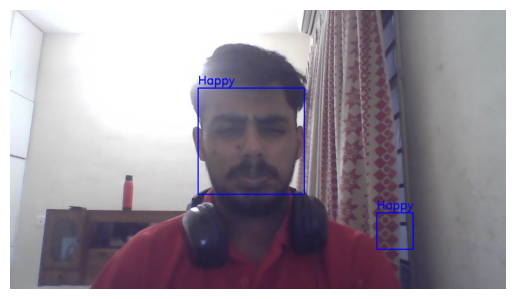

1/1 [==============================] - 0s 35ms/step


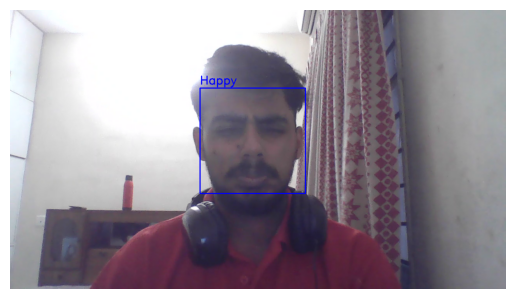

1/1 [==============================] - 0s 36ms/step


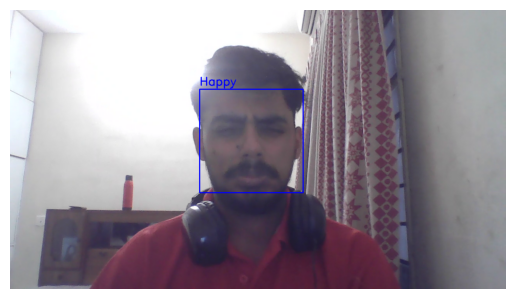

1/1 [==============================] - 0s 36ms/step


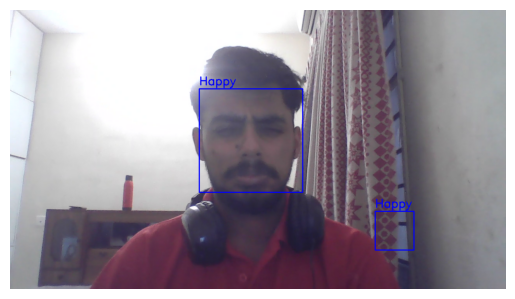

1/1 [==============================] - 0s 36ms/step


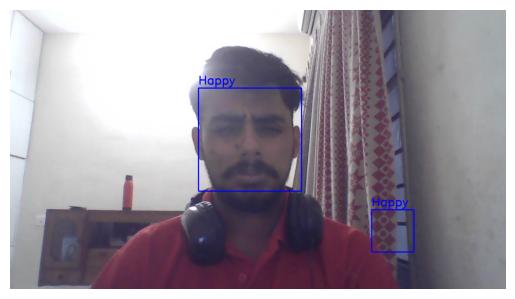

1/1 [==============================] - 0s 35ms/step


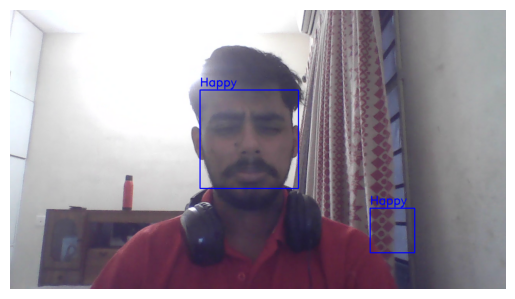

1/1 [==============================] - 0s 36ms/step


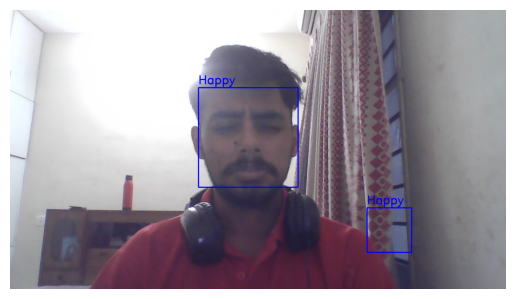

1/1 [==============================] - 0s 39ms/step


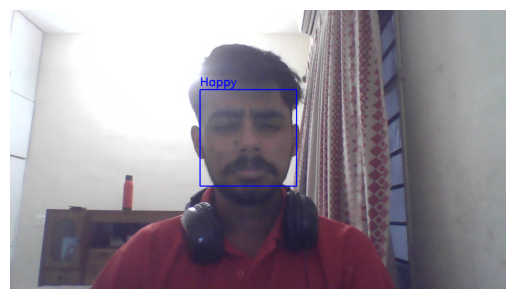

1/1 [==============================] - 0s 37ms/step


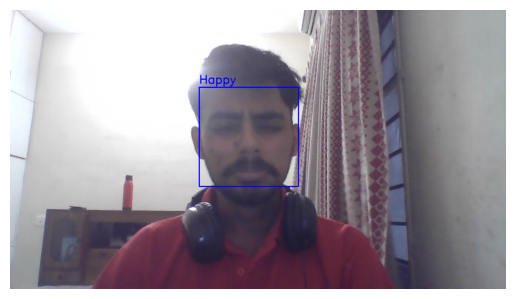

1/1 [==============================] - 0s 37ms/step


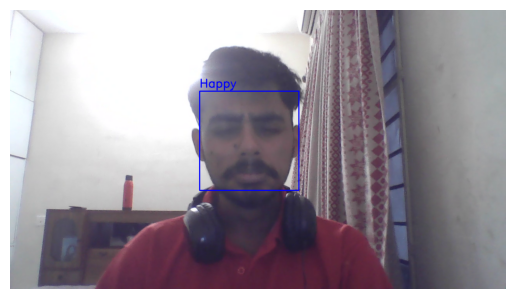

1/1 [==============================] - 0s 39ms/step


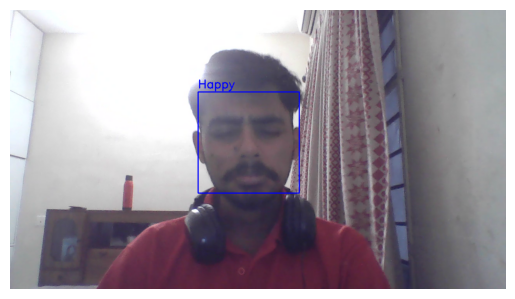

1/1 [==============================] - 0s 34ms/step


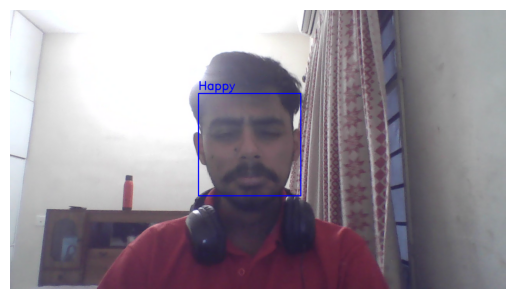

1/1 [==============================] - 0s 37ms/step


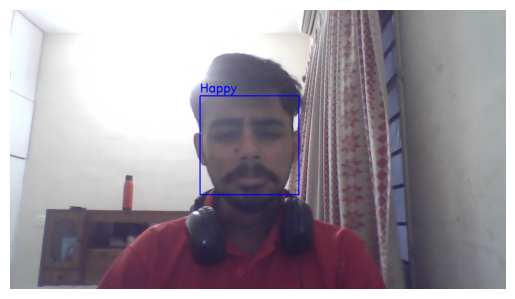

1/1 [==============================] - 0s 36ms/step


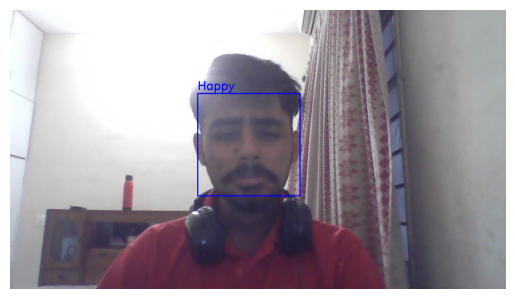

1/1 [==============================] - 0s 35ms/step


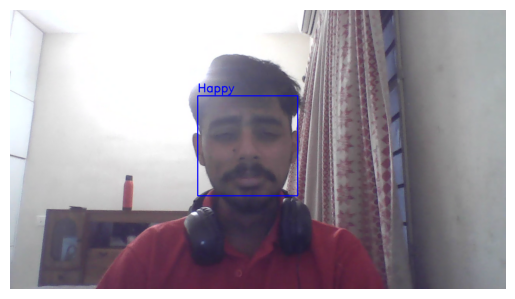

1/1 [==============================] - 0s 37ms/step


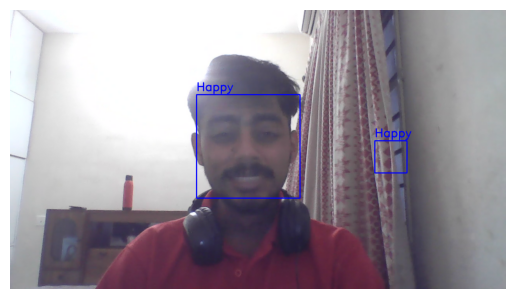

1/1 [==============================] - 0s 35ms/step


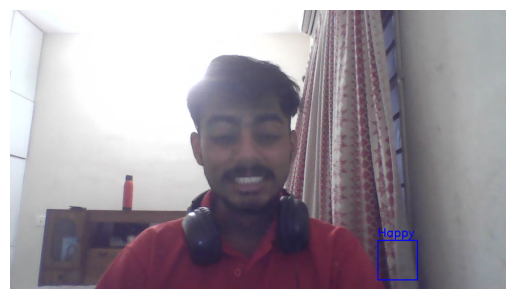

1/1 [==============================] - 0s 35ms/step


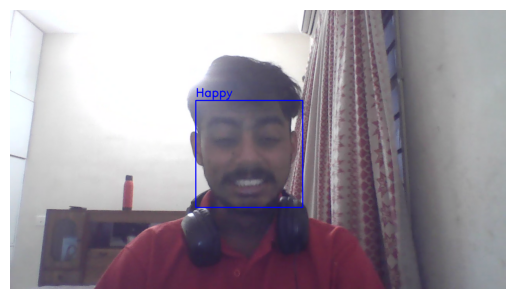

1/1 [==============================] - 0s 36ms/step


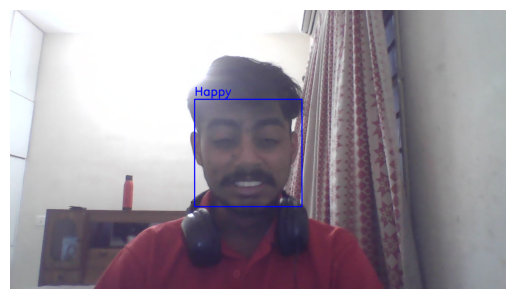

1/1 [==============================] - 0s 36ms/step


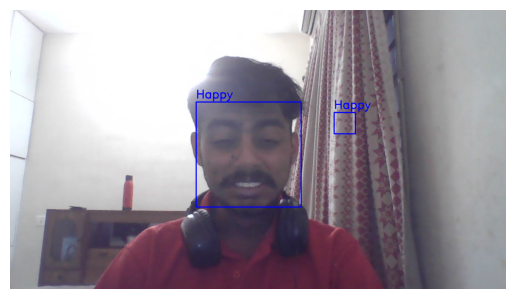

1/1 [==============================] - 0s 36ms/step


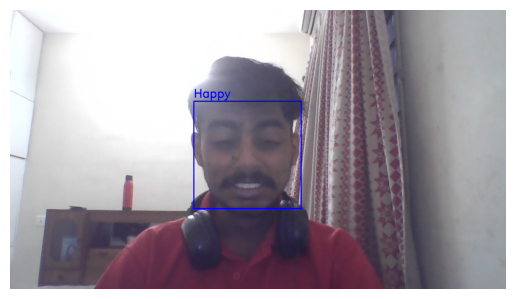

1/1 [==============================] - 0s 35ms/step


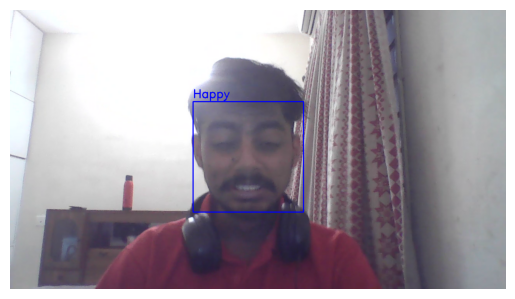

1/1 [==============================] - 0s 37ms/step


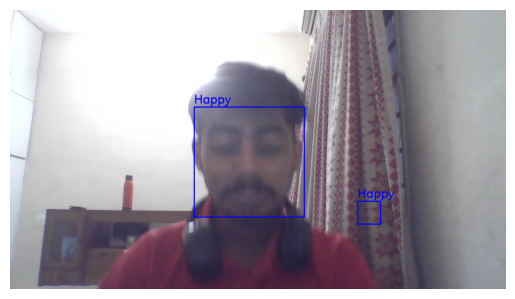

1/1 [==============================] - 0s 38ms/step


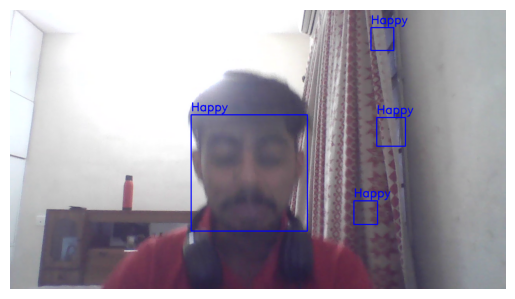

1/1 [==============================] - 0s 35ms/step


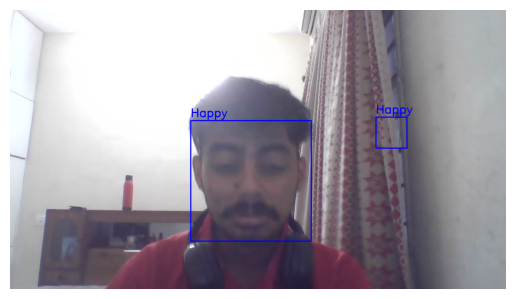

1/1 [==============================] - 0s 37ms/step


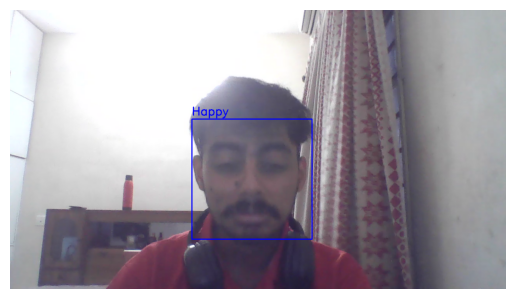

1/1 [==============================] - 0s 37ms/step


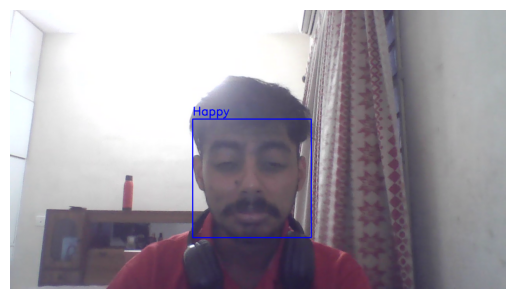

1/1 [==============================] - 0s 39ms/step


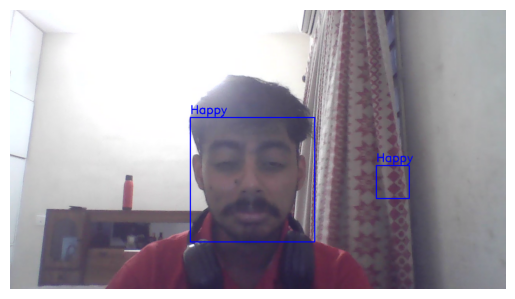

1/1 [==============================] - 0s 40ms/step


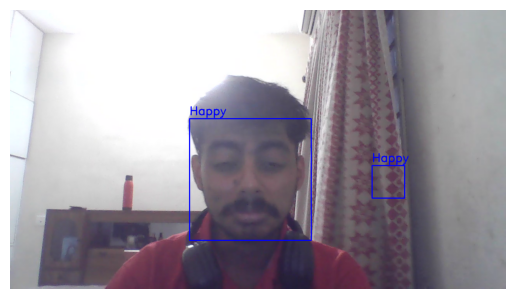

1/1 [==============================] - 0s 38ms/step


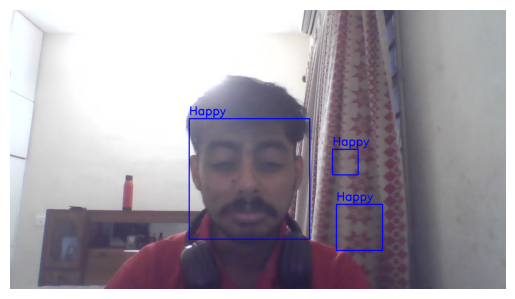

1/1 [==============================] - 0s 37ms/step


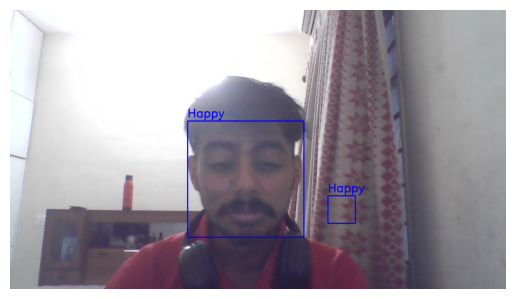

1/1 [==============================] - 0s 38ms/step


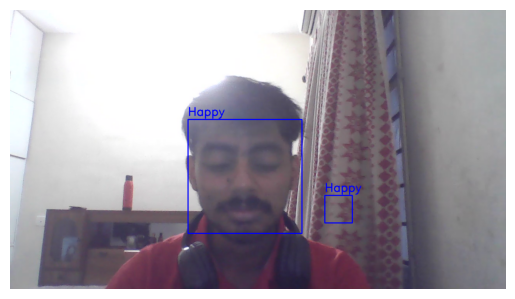

1/1 [==============================] - 0s 40ms/step


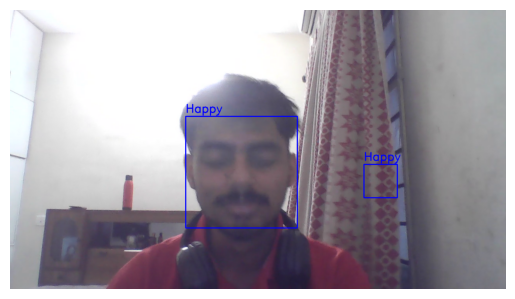

1/1 [==============================] - 0s 39ms/step


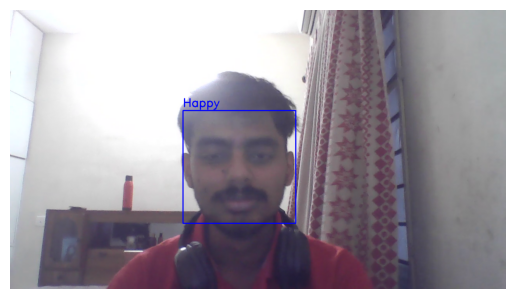

1/1 [==============================] - 0s 37ms/step


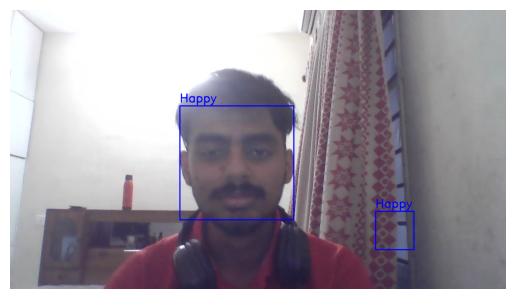

1/1 [==============================] - 0s 37ms/step


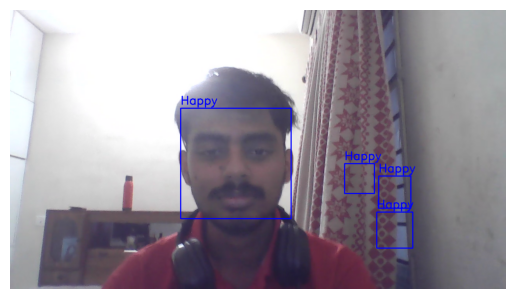

1/1 [==============================] - 0s 40ms/step


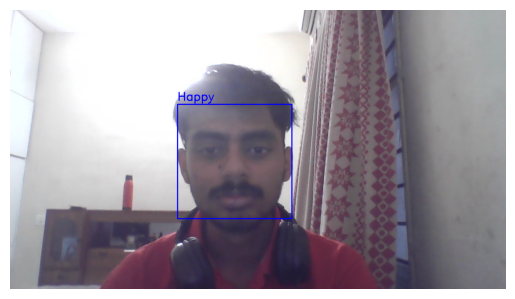

1/1 [==============================] - 0s 37ms/step


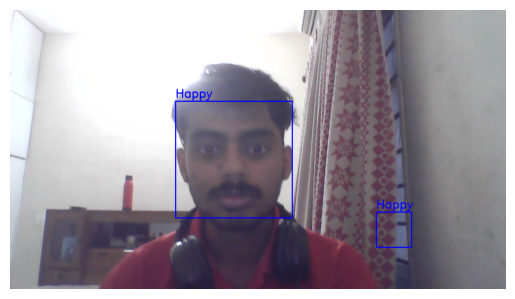

1/1 [==============================] - 0s 41ms/step


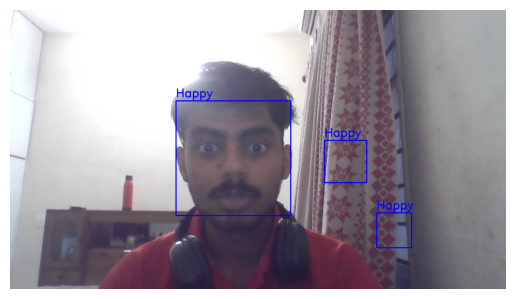

1/1 [==============================] - 0s 36ms/step


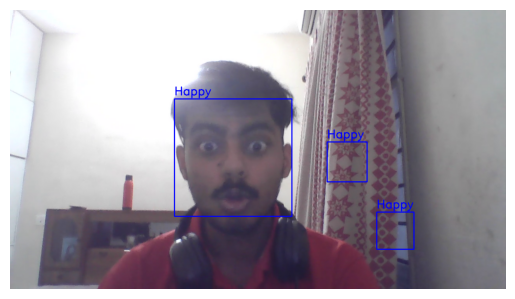

1/1 [==============================] - 0s 35ms/step


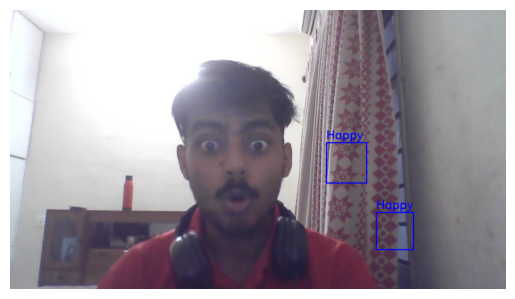

1/1 [==============================] - 0s 38ms/step


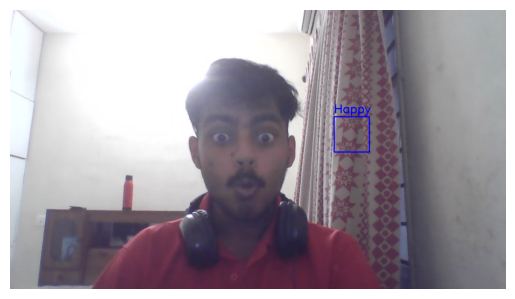

1/1 [==============================] - 0s 36ms/step


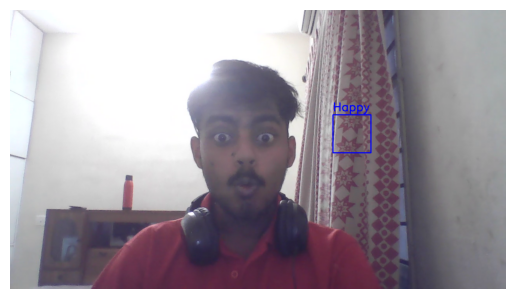

1/1 [==============================] - 0s 36ms/step


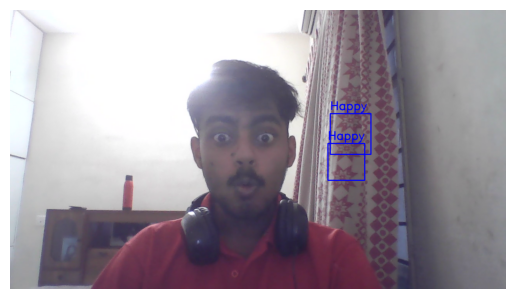

1/1 [==============================] - 0s 36ms/step


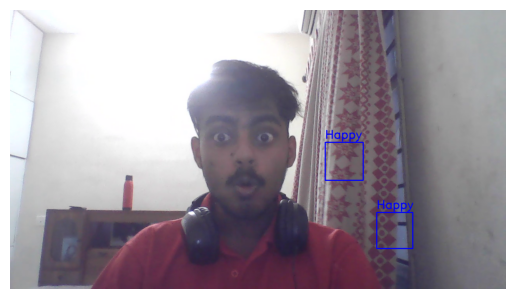

1/1 [==============================] - 0s 36ms/step


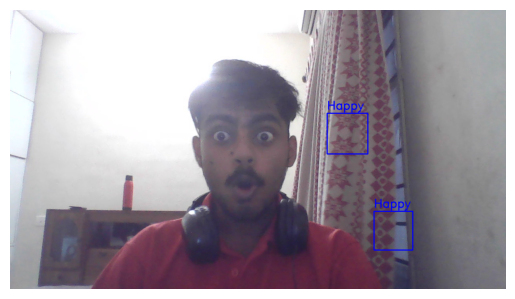

1/1 [==============================] - 0s 37ms/step


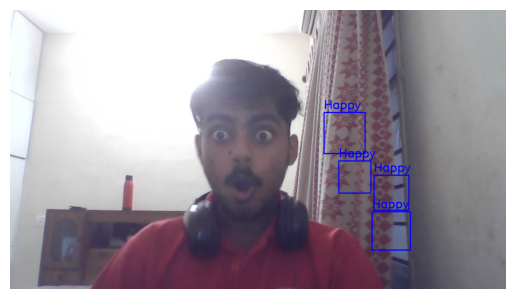

1/1 [==============================] - 0s 36ms/step


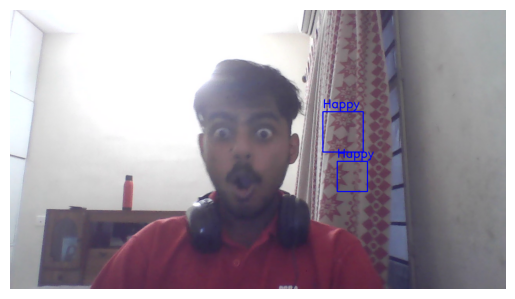

1/1 [==============================] - 0s 36ms/step


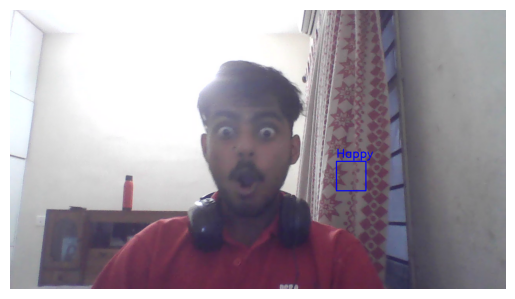

1/1 [==============================] - 0s 36ms/step


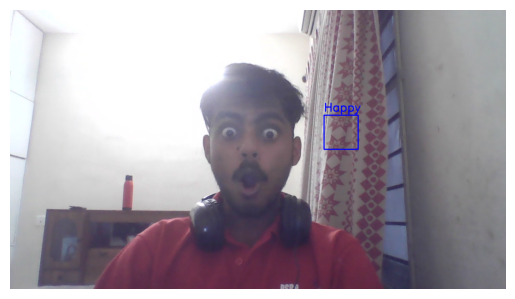

1/1 [==============================] - 0s 36ms/step


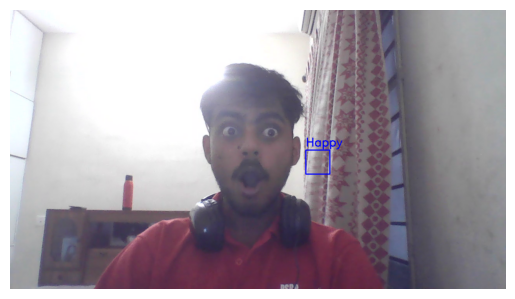

1/1 [==============================] - 0s 37ms/step


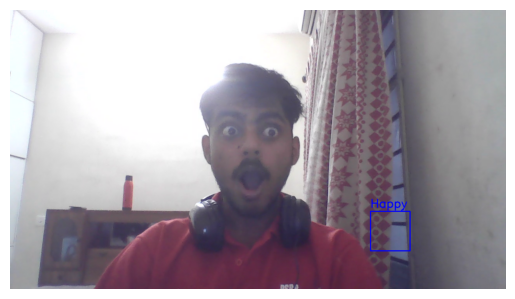

1/1 [==============================] - 0s 36ms/step


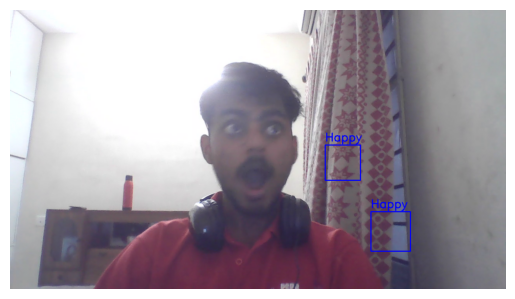

1/1 [==============================] - 0s 35ms/step


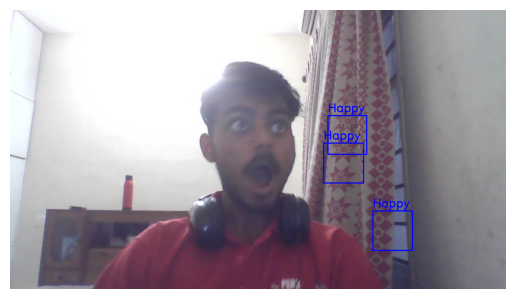

1/1 [==============================] - 0s 38ms/step


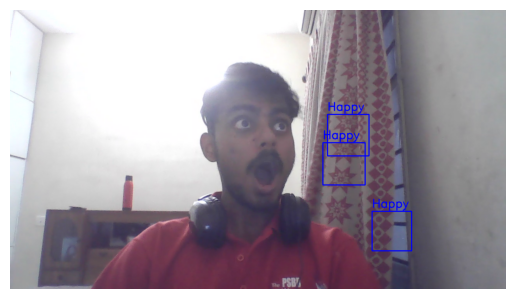

1/1 [==============================] - 0s 35ms/step


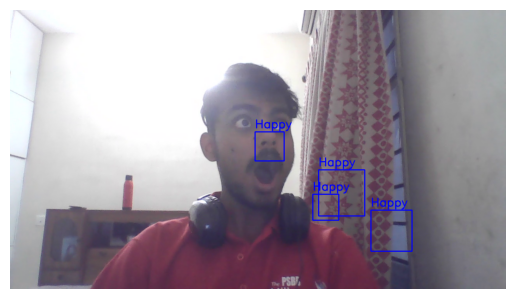

1/1 [==============================] - 0s 35ms/step


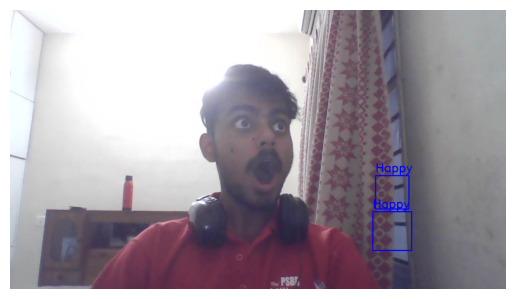

1/1 [==============================] - 0s 38ms/step


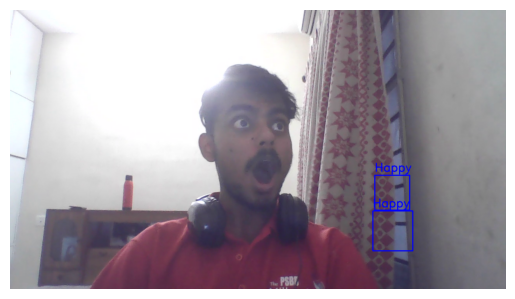

1/1 [==============================] - 0s 37ms/step


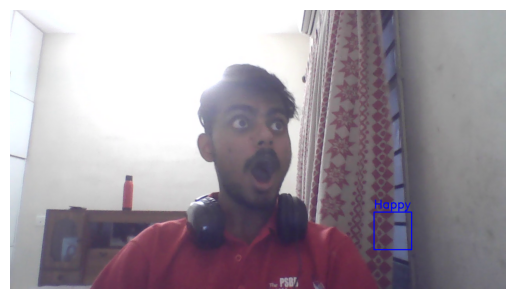

1/1 [==============================] - 0s 35ms/step


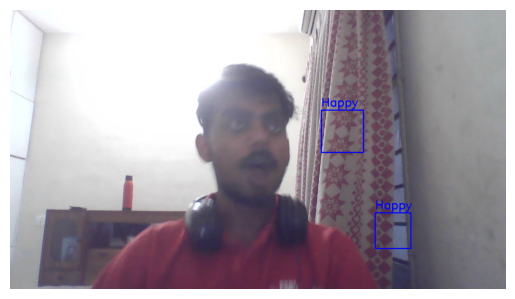

1/1 [==============================] - 0s 44ms/step


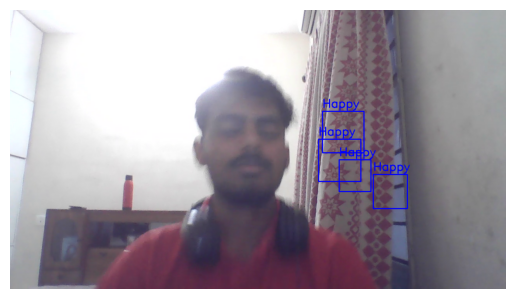

1/1 [==============================] - 0s 38ms/step


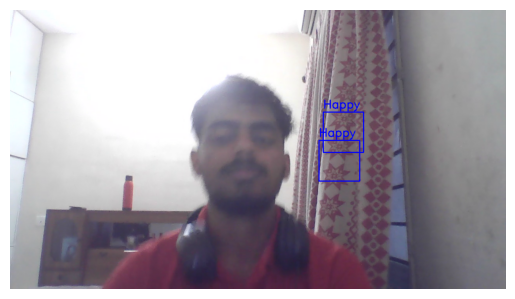

1/1 [==============================] - 0s 38ms/step


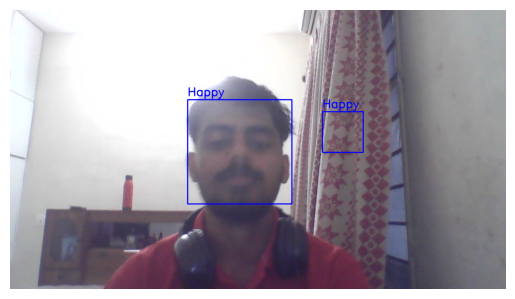

1/1 [==============================] - 0s 39ms/step


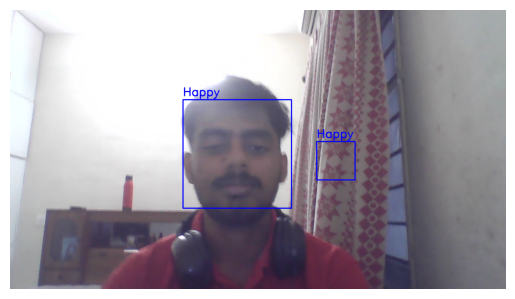

1/1 [==============================] - 0s 39ms/step


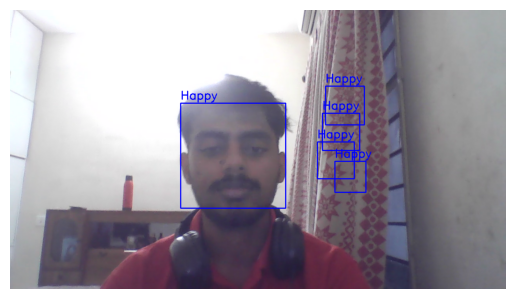

1/1 [==============================] - 0s 43ms/step


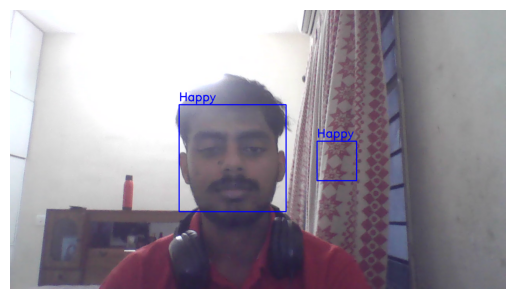

1/1 [==============================] - 0s 39ms/step


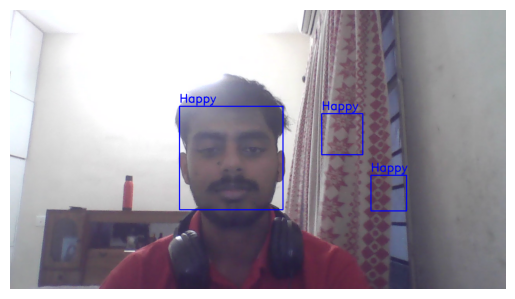

1/1 [==============================] - 0s 36ms/step


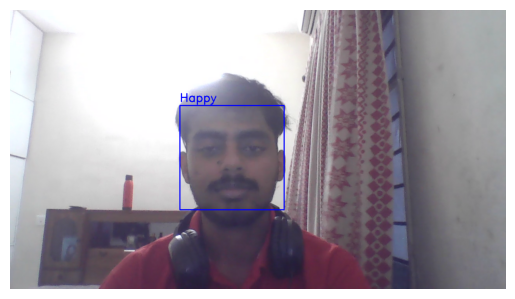

1/1 [==============================] - 0s 37ms/step


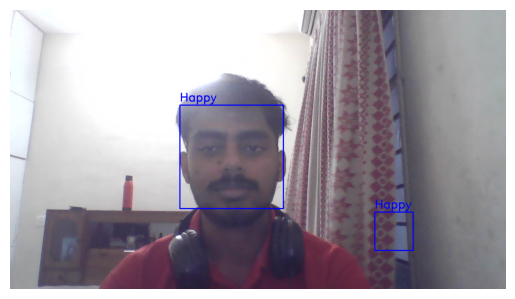

1/1 [==============================] - 0s 37ms/step


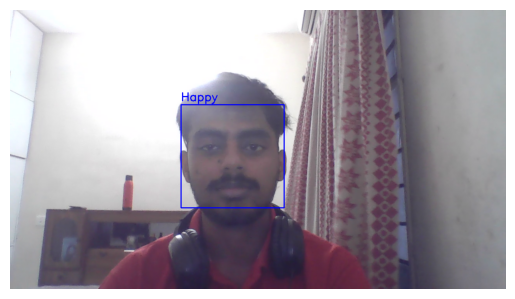

1/1 [==============================] - 0s 36ms/step


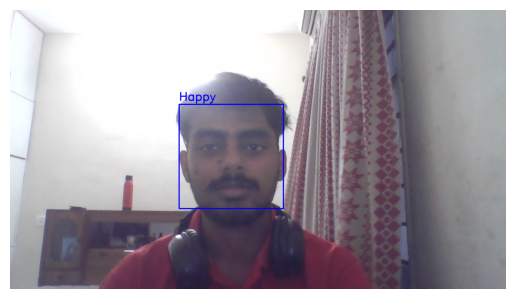

1/1 [==============================] - 0s 37ms/step


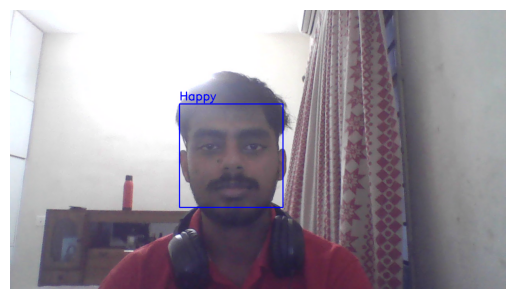

1/1 [==============================] - 0s 37ms/step


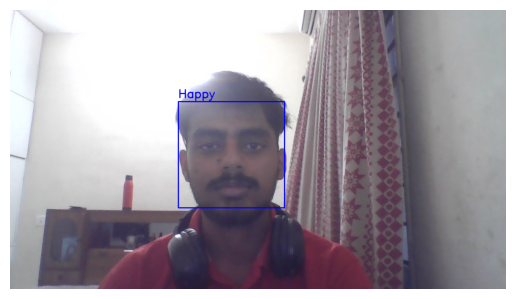

1/1 [==============================] - 0s 35ms/step


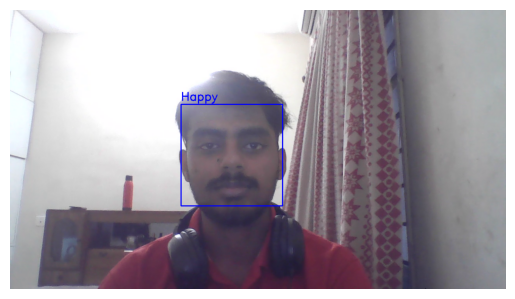

1/1 [==============================] - 0s 36ms/step


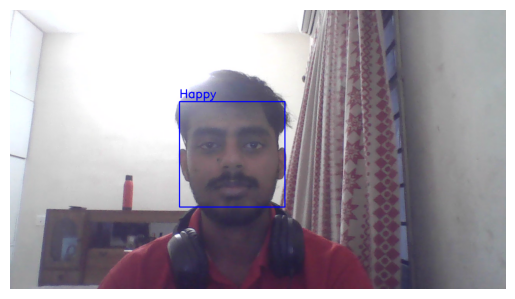

1/1 [==============================] - 0s 42ms/step


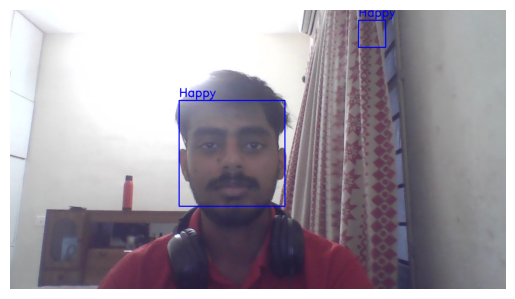

1/1 [==============================] - 0s 39ms/step


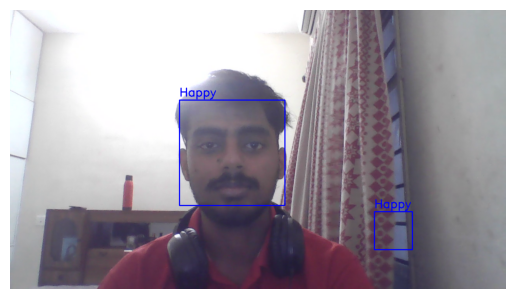

1/1 [==============================] - 0s 39ms/step


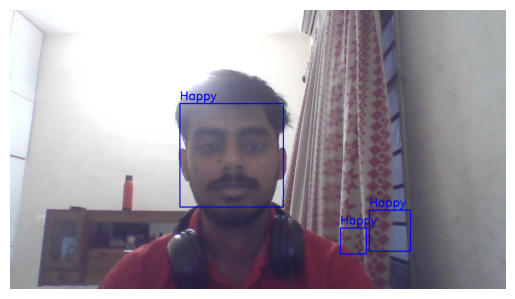

1/1 [==============================] - 0s 38ms/step


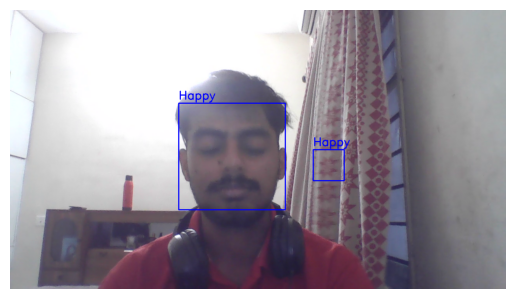

1/1 [==============================] - 0s 40ms/step


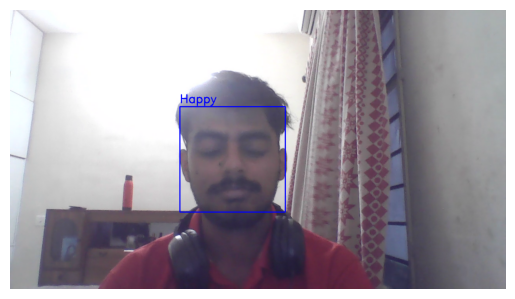

1/1 [==============================] - 0s 39ms/step


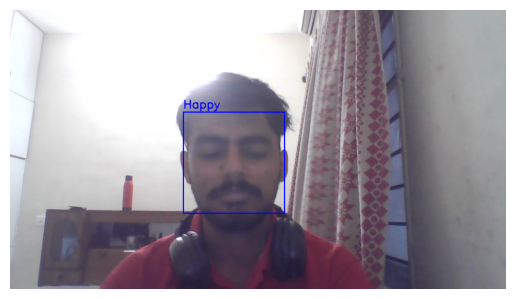

1/1 [==============================] - 0s 40ms/step


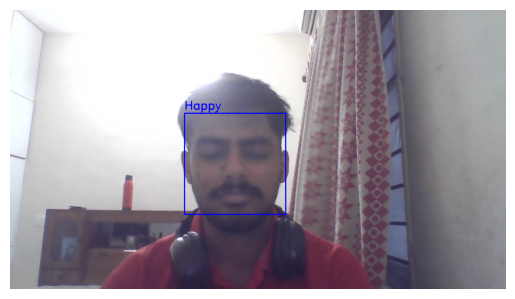

1/1 [==============================] - 0s 39ms/step


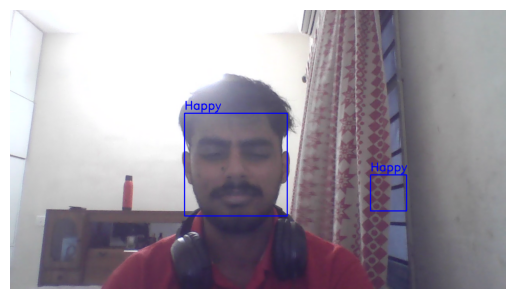

1/1 [==============================] - 0s 38ms/step


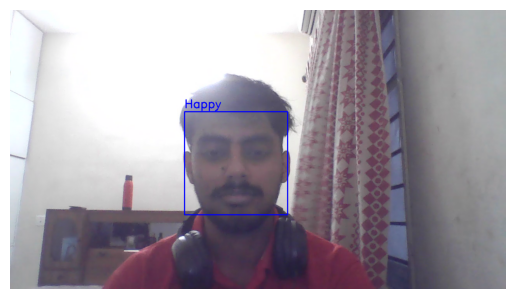

1/1 [==============================] - 0s 37ms/step


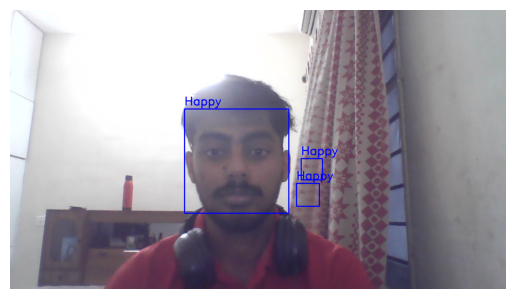

1/1 [==============================] - 0s 40ms/step


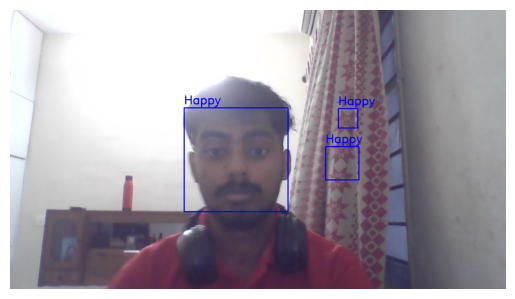

1/1 [==============================] - 0s 41ms/step


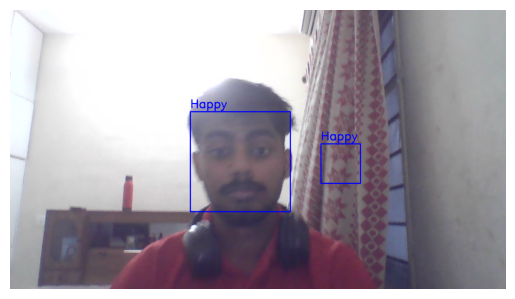

1/1 [==============================] - 0s 38ms/step


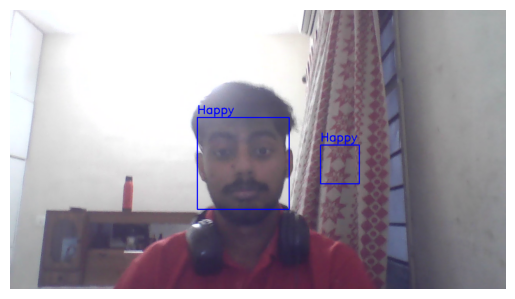

1/1 [==============================] - 0s 39ms/step


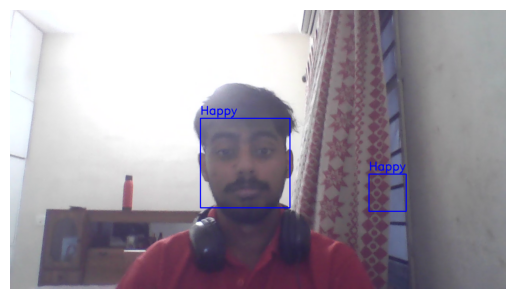

1/1 [==============================] - 0s 41ms/step


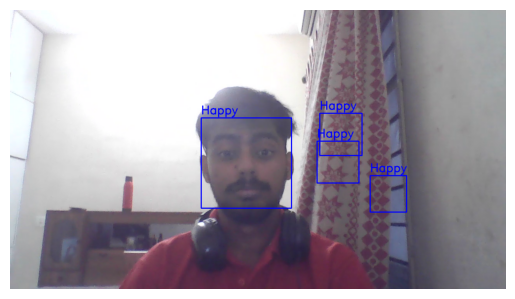

1/1 [==============================] - 0s 38ms/step


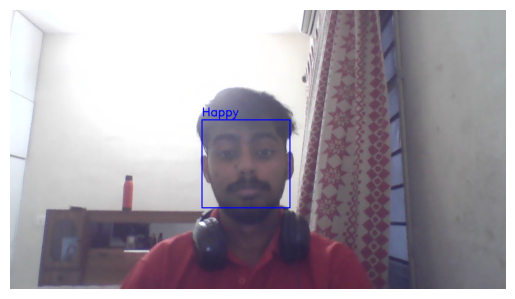

1/1 [==============================] - 0s 41ms/step


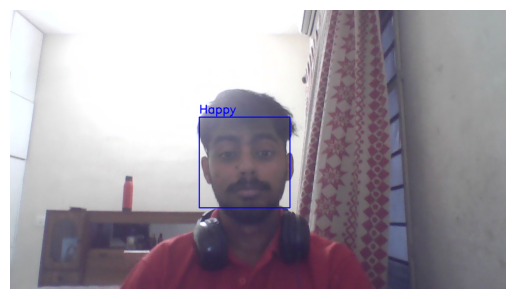

1/1 [==============================] - 0s 38ms/step


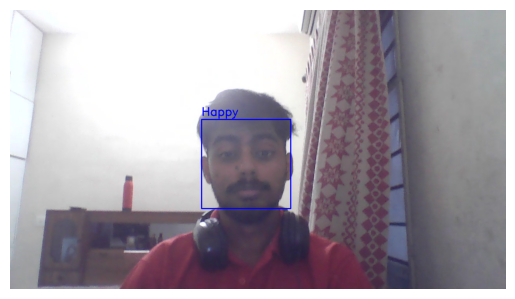

1/1 [==============================] - 0s 39ms/step


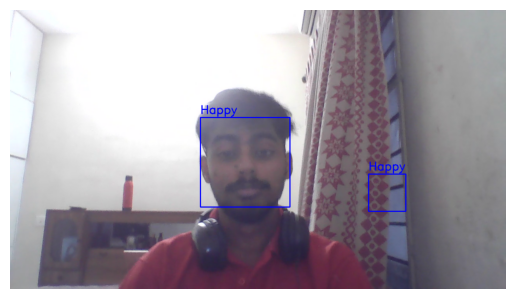

1/1 [==============================] - 0s 41ms/step


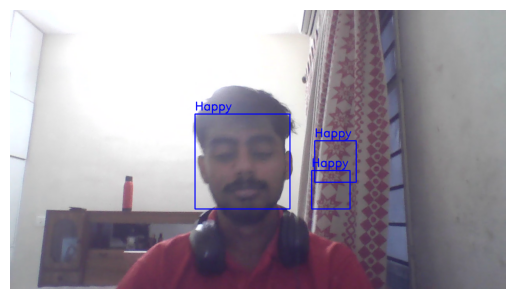

1/1 [==============================] - 0s 41ms/step


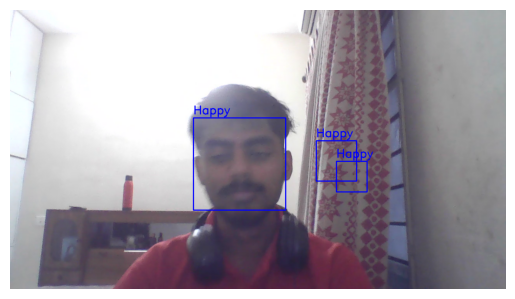

1/1 [==============================] - 0s 52ms/step


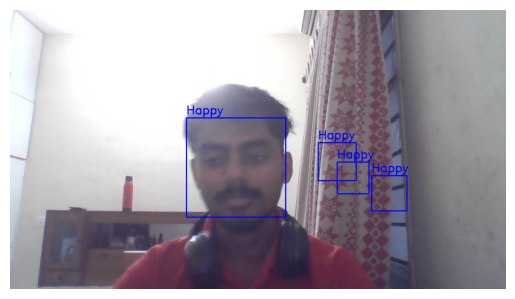

1/1 [==============================] - 0s 37ms/step


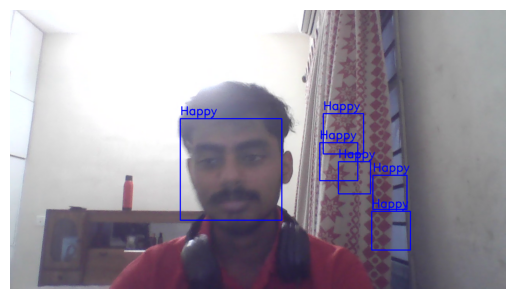

1/1 [==============================] - 0s 37ms/step


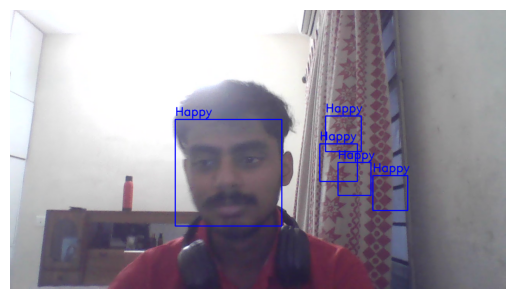

1/1 [==============================] - 0s 40ms/step


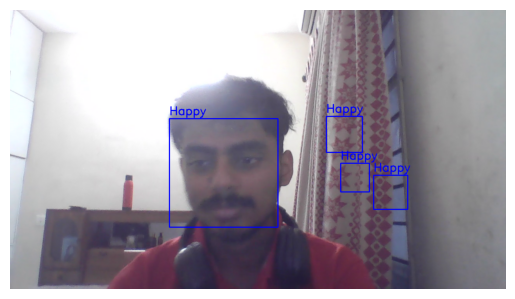

1/1 [==============================] - 0s 38ms/step


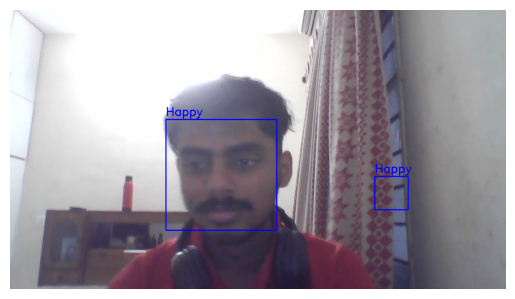

1/1 [==============================] - 0s 40ms/step


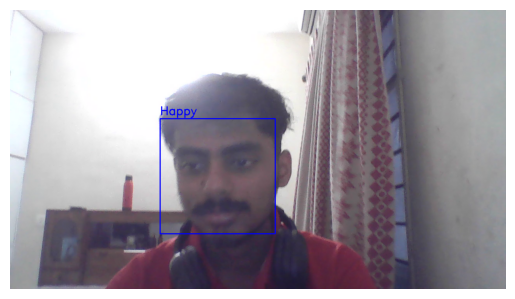

1/1 [==============================] - 0s 37ms/step


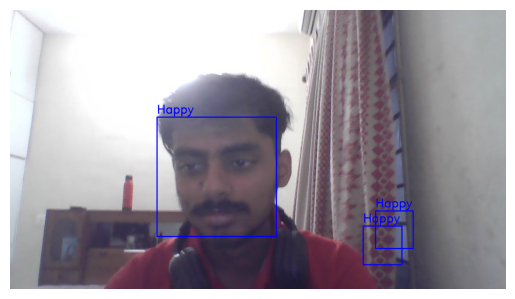

1/1 [==============================] - 0s 37ms/step


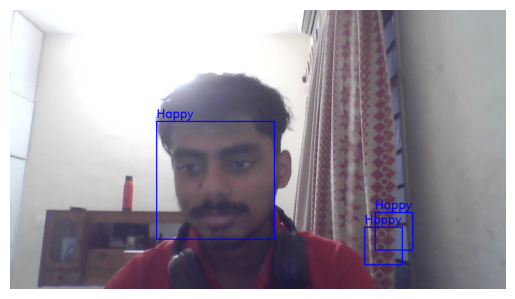

1/1 [==============================] - 0s 39ms/step


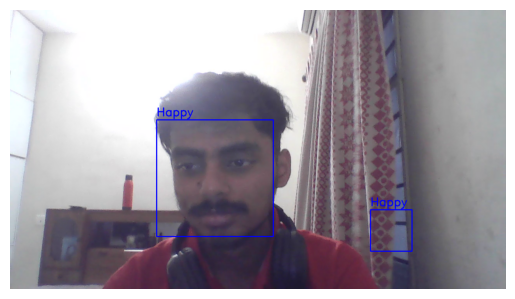

1/1 [==============================] - 0s 37ms/step


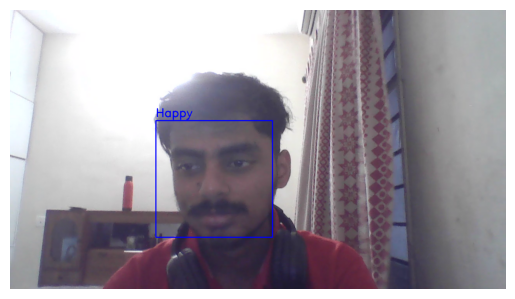

Reached the end of the video.


In [70]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Assuming new_model is already loaded
# Replace `new_model` with the actual model variable if it's not defined

# Load the face detection model
faceMark = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

# Emotion labels corresponding to the model output
emotion_labels = ["Angry", "Disgust", "Fear", "Happy", "Neutral", "Sad", "Surprise"]

# Function to display face and emotion label
def facemark(frame, emotion):
    gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)  # Convert frame to grayscale
    faces = faceMark.detectMultiScale(gray, 1.1, 4)  # Detect faces

    for (x, y, w, h) in faces:
        # Draw rectangle around the face
        cv2.rectangle(frame, (x, y), (x + w, y + h), (255, 0, 0), 2)
        # Display emotion text
        cv2.putText(frame, emotion, (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 0, 0), 2, cv2.LINE_4)

    # Show the frame with the face and emotion labels
    plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

# Path to the video file
cap = cv2.VideoCapture('/root/.cache/kagglehub/datasets/msambare/fer2013/versions/WIN_20241027_17_24_42_Pro.mp4')

while cap.isOpened():
    ret, frame = cap.read()  # Capture frame-by-frame
    if not ret:
        print("Reached the end of the video.")
        break  # Exit loop if no more frames

    try:
        # Detect faces and analyze emotions using new_model
        gray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
        faces = faceMark.detectMultiScale(gray, 1.1, 4)

        if len(faces) == 0:
            continue

        x, y, w, h = faces[0]
        face_roi = frame[y:y + h, x:x + w]
        final_image = cv2.resize(face_roi, (224, 224))  # Resize to the input size expected by the model
        final_image = np.expand_dims(final_image, axis=0)  # Add batch dimension
        final_image = final_image / 255.0  # Normalize the image

        # Predict emotion using new_model
        results = new_model.predict(final_image)
        dominant_emotion = emotion_labels[np.argmax(results)]  # Get the emotion with the highest probability

        # Display the emotion on the frame
        facemark(frame, dominant_emotion)

    except Exception as e:
        print(f"Error: {e}")
        continue

    # Wait for 'q' key to stop the loop
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()
